# Install Detectron2 Dependencies|

In [ ]:
# install dependencies: (use cu101 because colab has CUDA 10.1)
!pip install --upgrade torch==2.1.1+cu124 torchvision==0.16.1+cu124 \
  --index-url https://download.pytorch.org/whl/cu124

!pip install pyyaml

!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

Looking in indexes: https://download.pytorch.org/whl/cu124
ERROR: Could not find a version that satisfies the requirement torch==2.1.1+cu124 (from versions: 2.4.0+cu124, 2.4.1+cu124, 2.5.0+cu124, 2.5.1+cu124, 2.6.0+cu124)
ERROR: No matching distribution found for torch==2.1.1+cu124
  Cloning https://github.com/cocodataset/cocoapi.git to /tmp/pip-req-build-442fhojp
  Running command git clone --filter=blob:none --quiet https://github.com/cocodataset/cocoapi.git /tmp/pip-req-build-442fhojp
  Resolved https://github.com/cocodataset/cocoapi.git to commit 8c9bcc3cf640524c4c20a9c40e89cb6a2f2fa0e9
  Preparing metadata (setup.py) ... done
  Created wheel for pycocotools: filename=pycocotools-2.0-cp311-cp311-linux_x86_64.whl size=395985 sha256=78b49df18e6de142107c4ee4478c6becc3a99cfc146fe5717ea0d67cc503ea53
  Stored in directory: /tmp/pip-ephem-wheel-cache-ax4choth/wheels/6d/69/75/358c50a37672dfda8d74ba3b30ec49fb75d52f7c081886d503
Successfully built pycocotools
  Attempting uninstall: pycocotoo

In [ ]:
!pip install -U cython ninja pyyaml \
  'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI' \
  'git+https://github.com/facebookresearch/fvcore.git' iopath

!git clone https://github.com/facebookresearch/detectron2.git
%cd detectron2
!python -m pip install -e .


  Cloning https://github.com/cocodataset/cocoapi.git to /tmp/pip-req-build-xc38vo0p
  Running command git clone --filter=blob:none --quiet https://github.com/cocodataset/cocoapi.git /tmp/pip-req-build-xc38vo0p
  Resolved https://github.com/cocodataset/cocoapi.git to commit 8c9bcc3cf640524c4c20a9c40e89cb6a2f2fa0e9
  Preparing metadata (setup.py) ... done
  Cloning https://github.com/facebookresearch/fvcore.git to /tmp/pip-req-build-f51mqhug
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/fvcore.git /tmp/pip-req-build-f51mqhug
  Resolved https://github.com/facebookresearch/fvcore.git to commit b2ac9aba9354283ec11eb8f7b8891e6f63a0902b
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.2/42.2 kB 2.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.2/3.2 MB 38.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 422.8/422.8 kB 23.7 MB/s eta 0:00:

# Imports

Please restart your runtime before the next steps

In [ ]:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow
import os
import glob
import shutil
import json

from google.colab import drive
drive.mount('/content/drive')

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
from detectron2.data.catalog import DatasetCatalog
from detectron2.data.datasets import register_coco_instances
from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator
from detectron2.utils.visualizer import ColorMode

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Import dataset
Put your dataset's url from Roboflow to continue

In [ ]:
!curl -L "https://app.roboflow.com/ds/UxeU2cPGJW?key=12aBqZkBdw" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

# !curl -L "[YOUR URL]" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   901  100   901    0     0    959      0 --:--:-- --:--:-- --:--:--   960
100  140M  100  140M    0     0  28.8M      0  0:00:04  0:00:04 --:--:-- 38.9M
Archive:  roboflow.zip
  inflating: README.dataset.txt      
  inflating: README.roboflow.txt     
   creating: test/
 extracting: test/04962_png.rf.7bc9586d8e35ee529b4b85a996400e15.jpg  
 extracting: test/04965_png.rf.0c8c3869f980add26bb0e2a25a8e0d7a.jpg  
 extracting: test/04992_png.rf.b0aa28e776f1fcd580356de5772d790b.jpg  
 extracting: test/09005_png.rf.7cf365fbba5810899b2d1f838f6df652.jpg  
 extracting: test/09013_png.rf.14b870817f8e5b279c522ced936c60fa.jpg  
 extracting: test/09015_png.rf.31ff336655f2f31d0368304d63fe817c.jpg  
 extracting: test/09017_png.rf.6b89d3576b3971236fe0c2aa34843c9a.jpg  
 extracting: test/09038_png.rf.adb6fdd4b2b1e7e1cb4ba00d9ace91b5.jpg  
 extra

In [ ]:
register_coco_instances("my_dataset_train", {}, "/content/train/_annotations.coco.json", "/content/train")
register_coco_instances("my_dataset_val", {}, "/content/valid/_annotations.coco.json", "/content/valid")
register_coco_instances("my_dataset_test", {}, "/content/test/_annotations.coco.json", "/content/test")

# Additional functions

In [ ]:
class CocoTrainer(DefaultTrainer):
    @classmethod
    def build_evaluator(cls, cfg, dataset_name, output_folder=None):
        if output_folder is None:
            os.makedirs("coco_eval", exist_ok=True)
            output_folder = "coco_eval"
        return COCOEvaluator(dataset_name, cfg, False, output_folder)

In [ ]:
import cv2
import numpy as np

def draw_predictions_cv2(
    image: np.ndarray,
    outputs,
    metadata,
    score_threshold: float = 0.5,
    box_color: tuple = (0, 255, 0),
    text_color: tuple = (0, 0, 0),
    font_scale: float = 0.5,
    thickness: int = 1,
):

    with open("/content/test/_annotations.coco.json") as f:
        cats = json.load(f)["categories"]
    class_names = [c["name"] for c in cats]
    MetadataCatalog.get("my_dataset_test").set(thing_classes=class_names)

    img = image.copy()
    instances = outputs["instances"].to("cpu")
    boxes   = instances.pred_boxes.tensor.numpy().astype(int)  # shape (N,4)
    scores  = instances.scores.numpy()
    classes = instances.pred_classes.numpy()
    class_names = metadata.thing_classes

    for box, score, cls in zip(boxes, scores, classes):
        if score < score_threshold:
            continue

        x1, y1, x2, y2 = box
        cv2.rectangle(img, (x1, y1), (x2, y2), box_color, thickness)

        label = f"face {score:.2f}"
        ((text_w, text_h), baseline) = cv2.getTextSize(
            label, cv2.FONT_HERSHEY_SIMPLEX, font_scale, thickness
        )

        cv2.rectangle(img,(x1, y1 - text_h - baseline),(x1 + text_w, y1),box_color,cv2.FILLED,)
        cv2.putText(img, label,(x1, y1 - baseline),cv2.FONT_HERSHEY_SIMPLEX,font_scale,text_color,thickness,cv2.LINE_AA,)

    return img


# Declare constants

In [ ]:
checkpoint_path = '/content/drive/MyDrive/ML/projects/face_detection/models_checkpoints'

model_path = "COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml"

# Train Custom Faster R-CNN Detector

In [ ]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file(model_path))
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ("my_dataset_val",)


cfg.DATALOADER.NUM_WORKERS = 4
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url(model_path)
cfg.SOLVER.IMS_PER_BATCH = 4
cfg.SOLVER.BASE_LR = 0.001


cfg.SOLVER.WARMUP_ITERS = 1000
cfg.SOLVER.MAX_ITER = 1500
cfg.SOLVER.STEPS = (1000, 1400)
cfg.SOLVER.GAMMA = 0.05


cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 2 #your number of classes + 1

cfg.TEST.EVAL_PERIOD = 500


os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = CocoTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[06/22 11:42:23 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}


[06/22 11:42:24 d2.engine.train_loop]: Starting training from iteration 0
[06/22 11:42:43 d2.utils.events]:  eta: 0:23:41  iter: 19  total_loss: 2.214  loss_cls: 1.111  loss_box_reg: 1.081  loss_rpn_cls: 0.007691  loss_rpn_loc: 0.01312    time: 0.9522  last_time: 0.8340  data_time: 0.0524  last_data_time: 0.0260   lr: 1.931e-06  max_mem: 6248M
[06/22 11:43:04 d2.utils.events]:  eta: 0:24:12  iter: 39  total_loss: 2.15  loss_cls: 1.081  loss_box_reg: 1.051  loss_rpn_cls: 0.005304  loss_rpn_loc: 0.01305    time: 0.9949  last_time: 1.4831  data_time: 0.0392  last_data_time: 0.0366   lr: 2.911e-06  max_mem: 6566M
[06/22 11:43:22 d2.utils.events]:  eta: 0:23:33  iter: 59  total_loss: 2.088  loss_cls: 1.021  loss_box_reg: 1.044  loss_rpn_cls: 0.004599  loss_rpn_loc: 0.01347    time: 0.9746  last_time: 0.9736  data_time: 0.0276  last_data_time: 0.0205   lr: 3.891e-06  max_mem: 6566M
[06/22 11:43:41 d2.utils.events]:  eta: 0:23:00  iter: 79  total_loss: 2.042  loss_cls: 0.9656  loss_box_reg: 1

/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


[06/22 11:50:28 d2.evaluation.evaluator]: Inference done 11/209. Dataloading: 0.0013 s/iter. Inference: 0.1233 s/iter. Eval: 0.0004 s/iter. Total: 0.1249 s/iter. ETA=0:00:24
[06/22 11:50:33 d2.evaluation.evaluator]: Inference done 56/209. Dataloading: 0.0015 s/iter. Inference: 0.1116 s/iter. Eval: 0.0004 s/iter. Total: 0.1135 s/iter. ETA=0:00:17
[06/22 11:50:38 d2.evaluation.evaluator]: Inference done 95/209. Dataloading: 0.0052 s/iter. Inference: 0.1156 s/iter. Eval: 0.0004 s/iter. Total: 0.1214 s/iter. ETA=0:00:13
[06/22 11:50:43 d2.evaluation.evaluator]: Inference done 137/209. Dataloading: 0.0047 s/iter. Inference: 0.1159 s/iter. Eval: 0.0004 s/iter. Total: 0.1212 s/iter. ETA=0:00:08
[06/22 11:50:48 d2.evaluation.evaluator]: Inference done 180/209. Dataloading: 0.0046 s/iter. Inference: 0.1150 s/iter. Eval: 0.0004 s/iter. Total: 0.1202 s/iter. ETA=0:00:03
[06/22 11:50:53 d2.evaluation.evaluator]: Inference done 209/209. Dataloading: 0.0106 s/iter. Inference: 0.1169 s/iter. Eval: 0.

/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


[06/22 11:58:59 d2.evaluation.evaluator]: Inference done 11/209. Dataloading: 0.0027 s/iter. Inference: 0.1229 s/iter. Eval: 0.0004 s/iter. Total: 0.1260 s/iter. ETA=0:00:24
[06/22 11:59:04 d2.evaluation.evaluator]: Inference done 56/209. Dataloading: 0.0018 s/iter. Inference: 0.1114 s/iter. Eval: 0.0003 s/iter. Total: 0.1136 s/iter. ETA=0:00:17
[06/22 11:59:09 d2.evaluation.evaluator]: Inference done 98/209. Dataloading: 0.0036 s/iter. Inference: 0.1131 s/iter. Eval: 0.0003 s/iter. Total: 0.1171 s/iter. ETA=0:00:12
[06/22 11:59:14 d2.evaluation.evaluator]: Inference done 138/209. Dataloading: 0.0045 s/iter. Inference: 0.1149 s/iter. Eval: 0.0004 s/iter. Total: 0.1199 s/iter. ETA=0:00:08
[06/22 11:59:19 d2.evaluation.evaluator]: Inference done 181/209. Dataloading: 0.0042 s/iter. Inference: 0.1144 s/iter. Eval: 0.0004 s/iter. Total: 0.1191 s/iter. ETA=0:00:03
[06/22 11:59:24 d2.evaluation.evaluator]: Total inference time: 0:00:25.523537 (0.125115 s / iter per device, on 1 devices)
[06/

/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


[06/22 12:07:33 d2.evaluation.evaluator]: Inference done 11/209. Dataloading: 0.0025 s/iter. Inference: 0.1204 s/iter. Eval: 0.0003 s/iter. Total: 0.1232 s/iter. ETA=0:00:24
[06/22 12:07:39 d2.evaluation.evaluator]: Inference done 56/209. Dataloading: 0.0018 s/iter. Inference: 0.1112 s/iter. Eval: 0.0003 s/iter. Total: 0.1134 s/iter. ETA=0:00:17
[06/22 12:07:44 d2.evaluation.evaluator]: Inference done 93/209. Dataloading: 0.0088 s/iter. Inference: 0.1160 s/iter. Eval: 0.0005 s/iter. Total: 0.1253 s/iter. ETA=0:00:14
[06/22 12:07:49 d2.evaluation.evaluator]: Inference done 136/209. Dataloading: 0.0067 s/iter. Inference: 0.1154 s/iter. Eval: 0.0004 s/iter. Total: 0.1226 s/iter. ETA=0:00:08
[06/22 12:07:54 d2.evaluation.evaluator]: Inference done 179/209. Dataloading: 0.0059 s/iter. Inference: 0.1149 s/iter. Eval: 0.0004 s/iter. Total: 0.1213 s/iter. ETA=0:00:03
[06/22 12:07:59 d2.evaluation.evaluator]: Inference done 201/209. Dataloading: 0.0156 s/iter. Inference: 0.1176 s/iter. Eval: 0.

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 10351), started 0:34:57 ago. (Use '!kill 10351' to kill it.)

<IPython.core.display.Javascript object>

# Save checkpoints


In [ ]:
existing = []
next_version = 0
for name in os.listdir(checkpoint_path):
    next_version = int(name[-1])
next_version += 1


dest_dir = os.path.join(checkpoint_path, f'v_{next_version}')
os.makedirs(dest_dir, exist_ok=True)

!cp -r /content/output/. "{dest_dir}/"

# Testing and looking at the result

In [ ]:
%ls ./output/

events.out.tfevents.1750590456.d610b8969eb3.3126.0  metrics.json
last_checkpoint                                     model_final.pth


## Test evaluation

In [ ]:
cfg.MODEL.WEIGHTS = "/content/output/model_final.pth"
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.85
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("my_dataset_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_test")
inference_on_dataset(trainer.model, val_loader, evaluator)

[06/22 15:51:10 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/output/model_final.pth ...


AssertionError: Checkpoint /content/output/model_final.pth not found!

## Looking at test dataset

In [ ]:
cfg = get_cfg()

cfg.merge_from_file(model_zoo.get_config_file(
    "COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml"
))

cfg.OUTPUT_DIR = checkpoint_path + "/v_2" # chose right version

cfg.MODEL.ROI_HEADS.NUM_CLASSES = 2

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.DATASETS.TEST = ("my_dataset_test", )
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7
cfg.MODEL.DEVICE = "cpu"
predictor = DefaultPredictor(cfg)
test_metadata = MetadataCatalog.get("my_dataset_test")

[06/22 15:48:57 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/ML/projects/face_detection/models_checkpoints/v_2/model_final.pth ...


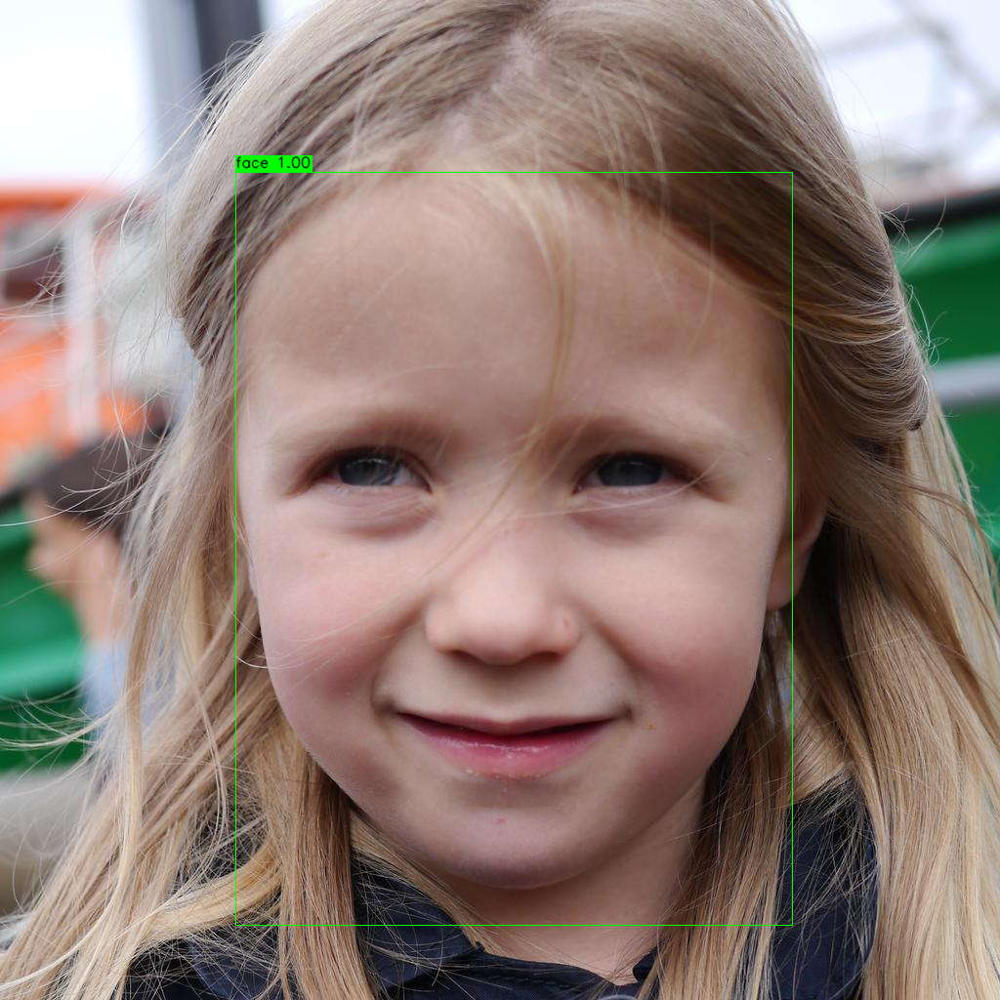

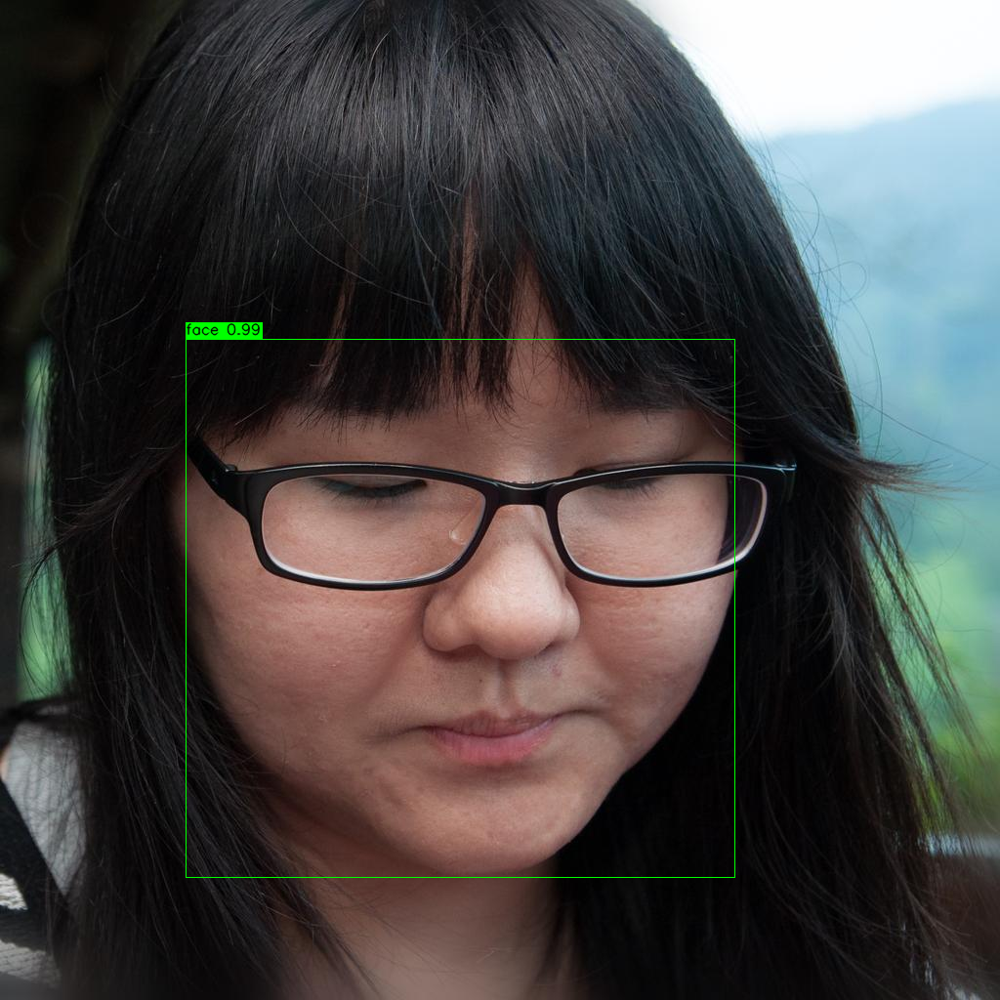

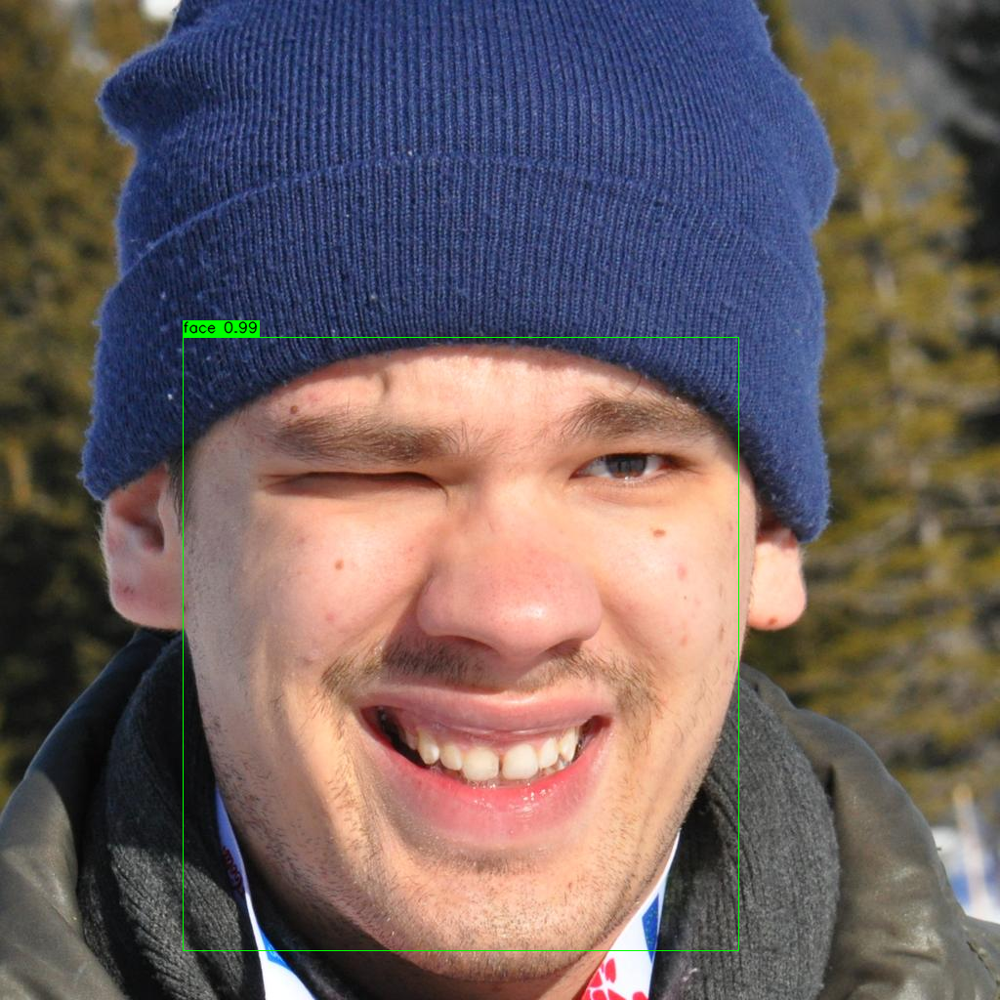

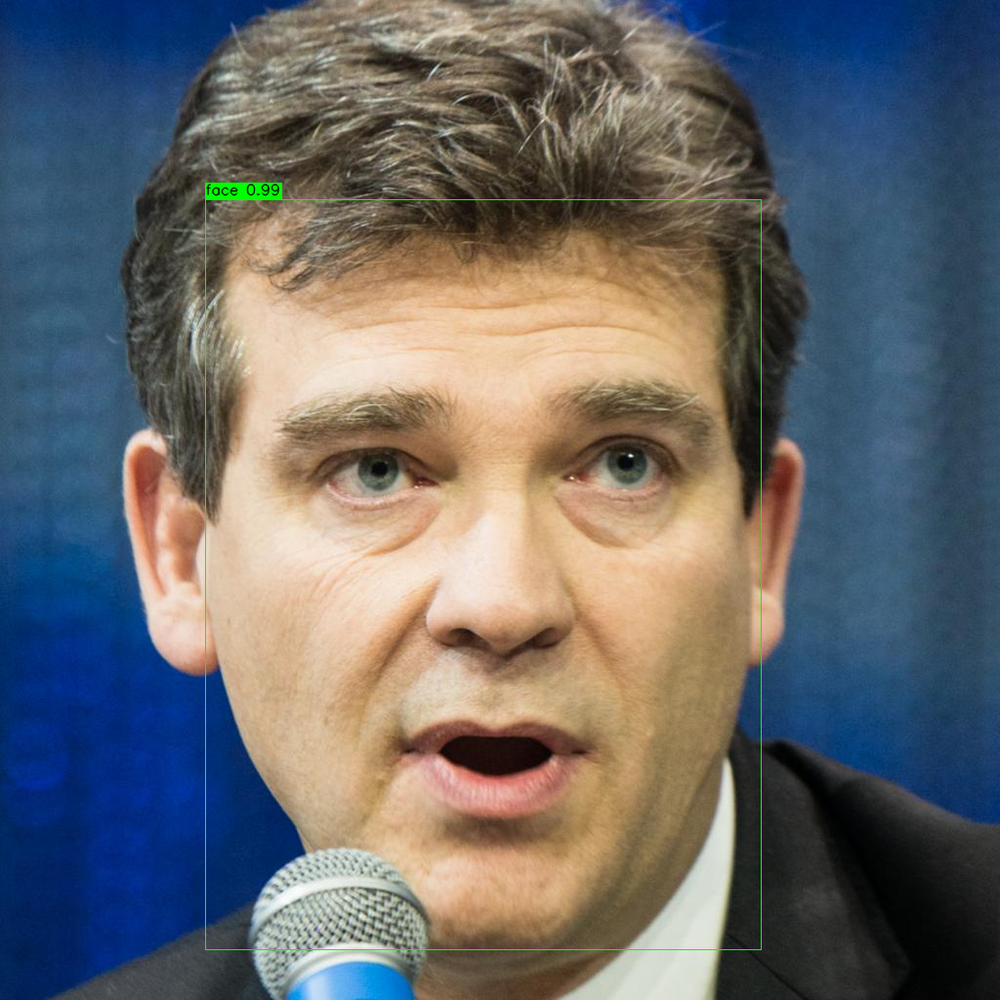

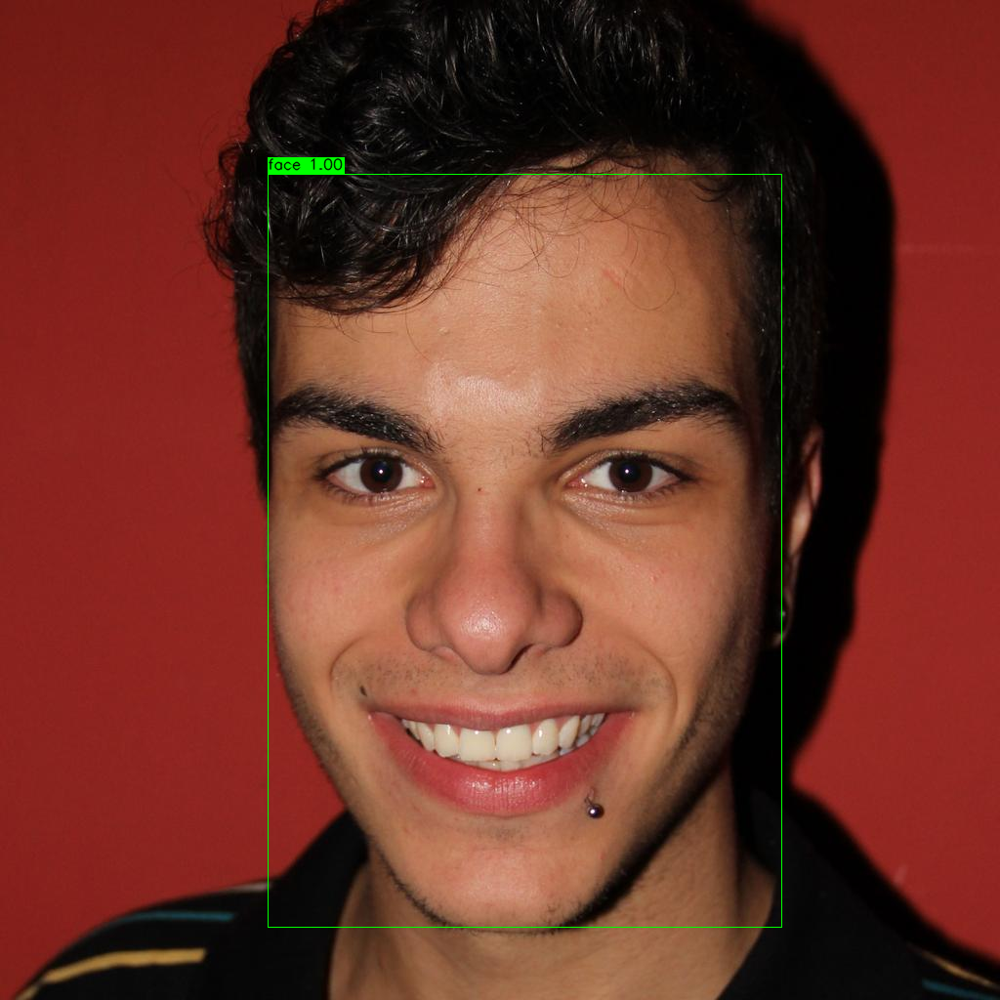

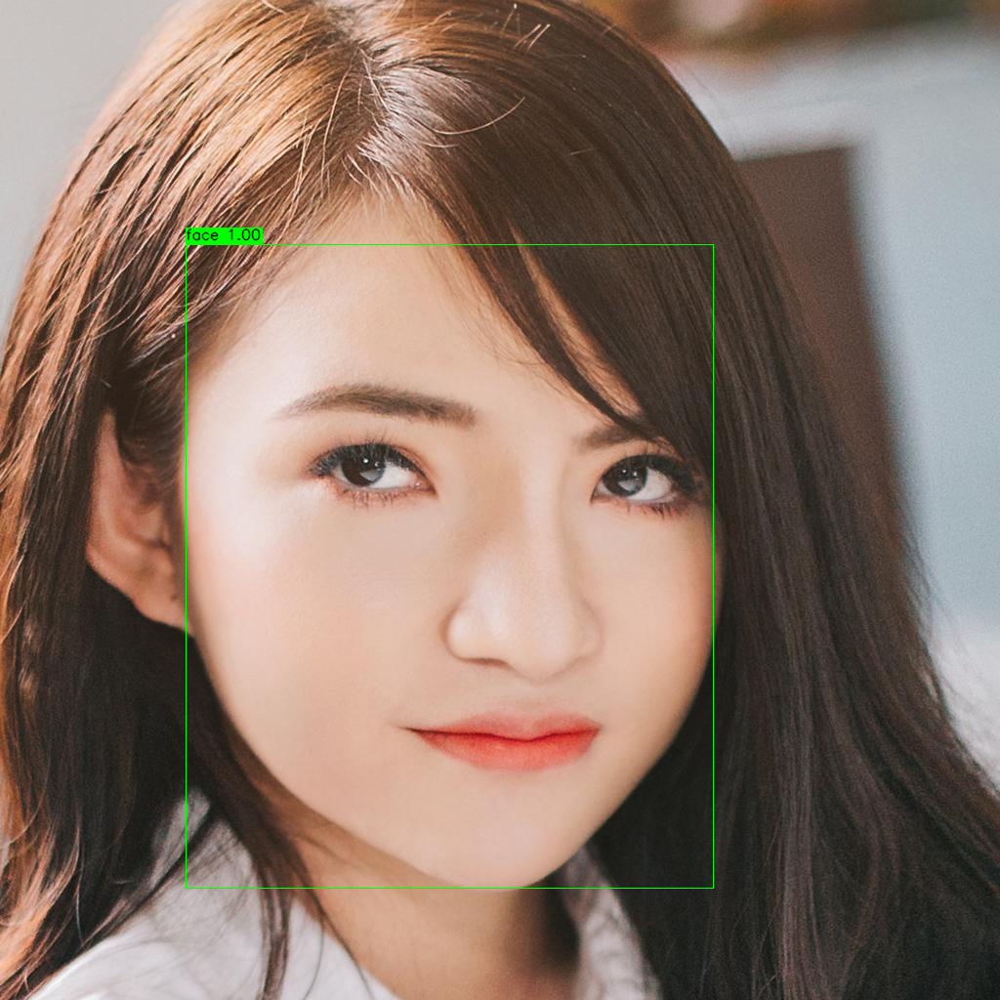

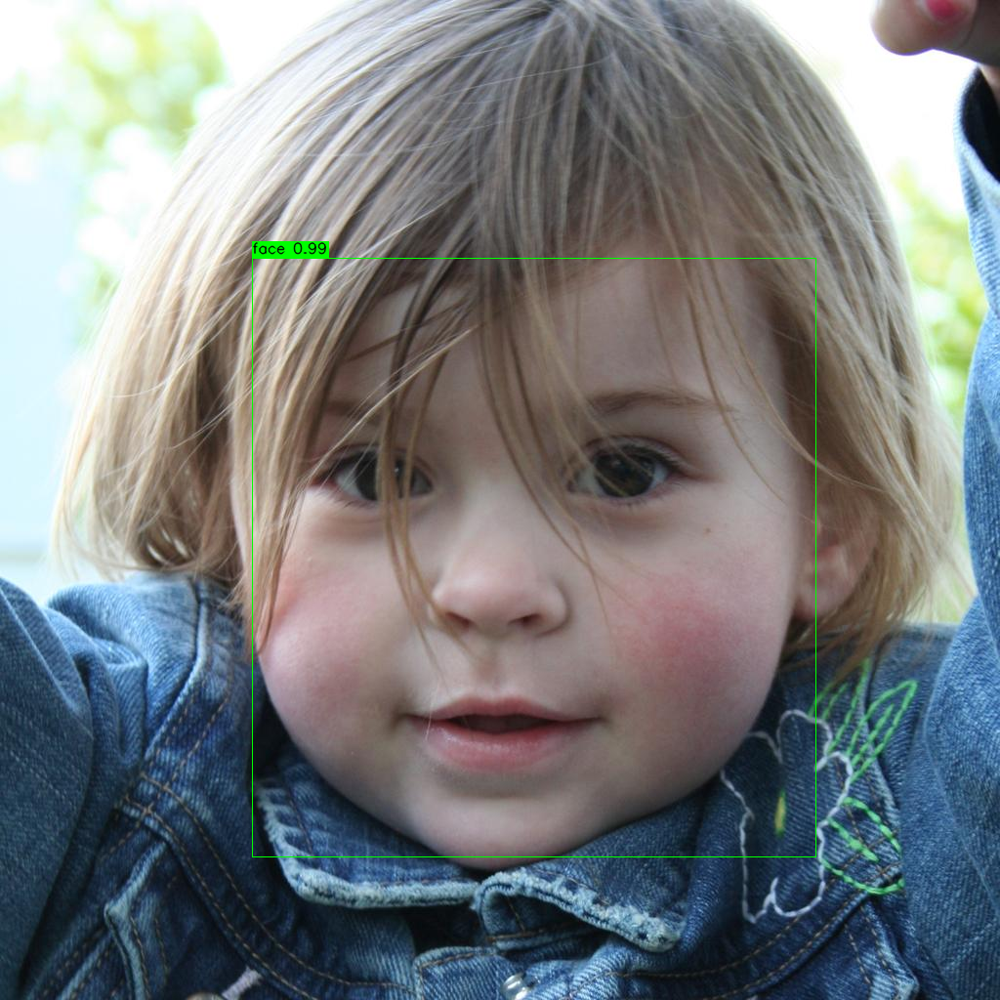

KeyboardInterrupt: 

In [ ]:
for imageName in glob.glob('/content/test/*jpg'):
    im = cv2.imread(imageName)
    outputs = predictor(im)
    vis = draw_predictions_cv2(im,outputs, metadata=test_metadata)
    cv2_imshow(vis)